# Análise de dados do IBGE para a cidade de Manaus-AM

<ul><font size=2 color=gray>FICHA TÉCNICA
<li><a href=https://www.kaggle.com/code/marcelobaliu/geo-c-introducao-a-analise-de-dados-geograficos/edit>Spatial Data Science: Análise de dados geográficos do IBGE para a cidade de Manaus-AM</a>
<li>Carga Horária: 3 h
    <li>Instrutora: <a href=https://br.linkedin.com/in/alice-adativa>Alice Adativa</a>
<!-- </ul> -->

<hr color=gray><br>
<h3><b>Conteúdo / Aprendizagem:</b></h3>

- Otenção de dados do IBGE (Setores Censitários e Resultado da Pesquisa);
- Tratamento de dados geográficos com GeoPandas;
- Visualização de dados geográficos com Folium e Contextily



## Resumo

Neste notebook, iremos explorar dados do Censo de 2010 do IBGE utilizando a linguagem Python e as bibliotecas Folium e GeoPandas.

1. Coleta de dados: download de ZIPs de Setores Censitários e Resultado do Censo do IBGE
2. Leitura de dados espaciais (SHP, GPKG, GeoJSON)


In [4]:
from shapely.geometry import Point
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import contextily  # mapas estáticos
import folium  # mapas dinâmicos

import os
from urllib.request import urlretrieve
import requests  # preferível
import zipfile

/opt/conda/lib/python3.7/site-packages/geopandas/_compat.py:115: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


In [5]:
# Padronização do estilo SNS
sns.set(font_scale=1.4)
sns.set_style({'font.family': 'serif',
               'fontname': 'Times New Roman'})

## 1) Fontes de dados

### 1.1) Setores censitários

* Fonte: [Instituto Brasileiro de Geografia e Estatística (IBGE)](https://www.ibge.gov.br/geociencias/organizacao-do-territorio/malhas-territoriais/26565-malhas-de-setores-censitarios-divisoes-intramunicipais.html?=&t=downloads)

In [6]:
# Ambiente de organização
save_folder = '/kaggle/working/mapas'
if not os.path.exists(save_folder):
    os.makedirs(save_folder)

# Dados dos Setores
url_setores_censitarios = 'https://geoftp.ibge.gov.br/organizacao_do_territorio/malhas_territoriais/malhas_de_setores_censitarios__divisoes_intramunicipais/censo_2010/setores_censitarios_shp/am/am_setores_censitarios.zip'

In [7]:
%%time
# Download de arquivos ZIP da web e extração dos dados

data_path = '/kaggle/working/mapas/am_setores_censitarios.zip'
urlretrieve(url_setores_censitarios, data_path)


with zipfile.ZipFile(data_path) as zip_ref:
    zip_ref.extractall(save_folder)
    
#os.remove(data_path)

CPU times: user 176 ms, sys: 47.4 ms, total: 223 ms
Wall time: 2.17 s


In [8]:
""" Operação mais verbosa e lenta do que a retrieve
%%time

res = requests.get(url_setores_censitarios, stream=True)
save_path = '/kaggle/working/mapas/am_setores_censitarios_req.zip'
with open(save_path, 'wb') as fd:
    chunk_size = 256
    for chunk in res.iter_content(chunk_size=chunk_size):
        fd.write(chunk)
"""

" Operação mais verbosa e lenta do que a retrieve\n%%time\n\nres = requests.get(url_setores_censitarios, stream=True)\nsave_path = '/kaggle/working/mapas/am_setores_censitarios_req.zip'\nwith open(save_path, 'wb') as fd:\n    chunk_size = 256\n    for chunk in res.iter_content(chunk_size=chunk_size):\n        fd.write(chunk)\n"

### Verificação dos dados

In [9]:
am_setores_shp = '/kaggle/working/mapas/13SEE250GC_SIR.shp'
am_setores_shp = '/kaggle/working/mapas/am_setores_censitarios.zip'

# GeoPandas lê tanto arquivo SHP quanto o ZIP
am_setores_gdf = gpd.read_file(data_path)
am_setores_gdf.head()

,ID,CD_GEOCODI,TIPO,CD_GEOCODB,NM_BAIRRO,CD_GEOCODS,NM_SUBDIST,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MUNICIP,NM_MICRO,NM_MESO,geometry
0,3215,130260305060048,URBANO,130260305001,Centro,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-60.01540 -3.13318, -60.01523 -3.132..."
1,3216,130260305060049,URBANO,130260305001,Centro,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-60.01451 -3.13691, -60.01469 -3.136..."
2,3217,130260305060050,URBANO,130260305001,Centro,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-60.01043 -3.13480, -60.01043 -3.134..."
3,3218,130260305060051,URBANO,130260305002,Nossa Senhora Aparecida,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-60.02882 -3.12463, -60.02882 -3.124..."
4,3219,130260305060052,URBANO,130260305002,Nossa Senhora Aparecida,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-60.02882 -3.12463, -60.02879 -3.123..."


In [10]:
# Formato da Tabela
am_setores_gdf.shape

# >> 6.184 registros
# >> 14 campos

(6184, 14)

In [11]:
# Colunas
am_setores_gdf.columns.to_list()

['ID',
 'CD_GEOCODI',
 'TIPO',
 'CD_GEOCODB',
 'NM_BAIRRO',
 'CD_GEOCODS',
 'NM_SUBDIST',
 'CD_GEOCODD',
 'NM_DISTRIT',
 'CD_GEOCODM',
 'NM_MUNICIP',
 'NM_MICRO',
 'NM_MESO',
 'geometry']

In [12]:
# Descrição da Tabela ou Tipos de Dados
am_setores_gdf.describe()

,ID
count,6184.000000
mean,3992.500000
std,1785.311364
min,901.000000
25%,2446.750000
50%,3992.500000
75%,5538.250000
max,7084.000000


In [13]:
# CRS
print('EPSG:', am_setores_gdf.crs.to_string(), '\n')

print('EPSG:', am_setores_gdf.crs.to_epsg())
print('PROJ4:', am_setores_gdf.crs.to_proj4())

#am_setores_gdf.crs.to_json()

EPSG: GEOGCS["SIRGAS 2000",DATUM["D_SIRGAS2000",SPHEROID["Geodetic_Reference_System_of_1980",6378137,298.257222100911]],PRIMEM["Greenwich",0],UNIT["Degree",0.0174532925199433],AXIS["Longitude",EAST],AXIS["Latitude",NORTH]] 

EPSG: None
PROJ4: +proj=longlat +ellps=GRS80 +no_defs +type=crs


/opt/conda/lib/python3.7/site-packages/pyproj/crs/crs.py:1216: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  return self._crs.to_proj4(version=version)


In [14]:
# Inspeção de Células
# Linha
am_setores_gdf.iloc[0]

ID                                                         3215
CD_GEOCODI                                      130260305060048
TIPO                                                     URBANO
CD_GEOCODB                                         130260305001
NM_BAIRRO                                                Centro
CD_GEOCODS                                          13026030506
NM_SUBDIST                                        PRIMEIRA R.A.
CD_GEOCODD                                            130260305
NM_DISTRIT                                               MANAUS
CD_GEOCODM                                              1302603
NM_MUNICIP                                               MANAUS
NM_MICRO                                                 MANAUS
NM_MESO                                       CENTRO AMAZONENSE
geometry      POLYGON ((-60.015403 -3.133185, -60.0152329999...
Name: 0, dtype: object

In [15]:
# Coluna
am_setores_gdf['TIPO'].unique()

array(['URBANO', 'RURAL'], dtype=object)

In [16]:
# Célula
am_setores_gdf['TIPO'].iloc[0]

'URBANO'

In [17]:
%timeit am_setores_gdf['TIPO'].iloc[0]  # mais rápido
%timeit am_setores_gdf.iloc[0]['TIPO']  # mais lento 13x
%timeit am_setores_gdf.iloc[0].TIPO  # mais lento 15x

14 µs ± 285 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)
206 µs ± 3.68 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)
210 µs ± 2.06 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)


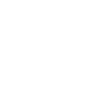

In [18]:
# Geometria
am_setores_gdf['geometry'].iloc[0]

### Transformações Espaciais

- Transformação de SRC
- Visualização

In [19]:
# Transofrmação de SRC
am_setores_gdf = am_setores_gdf.to_crs(crs='EPSG:3857')

In [20]:
def crs_describe(gdf):
    # CRS
    import json
    print('SRC:', gdf.crs.to_string(), '\n')


    print('Nome:', json.loads(gdf.crs.to_json())['name'])
    print('EPSG:', gdf.crs.to_epsg())
    print('Tipo:', json.loads(gdf.crs.to_json())['type'], json.loads(gdf.crs.to_json())['coordinate_system']['subtype'])
    print('Unidade:', gdf.crs.to_dict()['units'])

    print('\nPROJ4:', gdf.crs.to_proj4())

    print('\nJSON:', json.loads(gdf.crs.to_json()))

crs_describe(am_setores_gdf)

SRC: EPSG:3857 

Nome: WGS 84 / Pseudo-Mercator
EPSG: 3857
Tipo: ProjectedCRS Cartesian
Unidade: m

PROJ4: +proj=merc +a=6378137 +b=6378137 +lat_ts=0 +lon_0=0 +x_0=0 +y_0=0 +k=1 +units=m +nadgrids=@null +wktext +no_defs +type=crs

JSON: {'$schema': 'https://proj.org/schemas/v0.2/projjson.schema.json', 'type': 'ProjectedCRS', 'name': 'WGS 84 / Pseudo-Mercator', 'base_crs': {'name': 'WGS 84', 'datum': {'type': 'GeodeticReferenceFrame', 'name': 'World Geodetic System 1984', 'ellipsoid': {'name': 'WGS 84', 'semi_major_axis': 6378137, 'inverse_flattening': 298.257223563}}, 'coordinate_system': {'subtype': 'ellipsoidal', 'axis': [{'name': 'Geodetic latitude', 'abbreviation': 'Lat', 'direction': 'north', 'unit': 'degree'}, {'name': 'Geodetic longitude', 'abbreviation': 'Lon', 'direction': 'east', 'unit': 'degree'}]}, 'id': {'authority': 'EPSG', 'code': 4326}}, 'conversion': {'name': 'Popular Visualisation Pseudo-Mercator', 'method': {'name': 'Popular Visualisation Pseudo Mercator', 'id': {'au

/opt/conda/lib/python3.7/site-packages/pyproj/crs/crs.py:1216: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  return self._crs.to_proj4(version=version)


### Visualização

https://geopandas.org/en/stable/docs/user_guide/mapping.html#

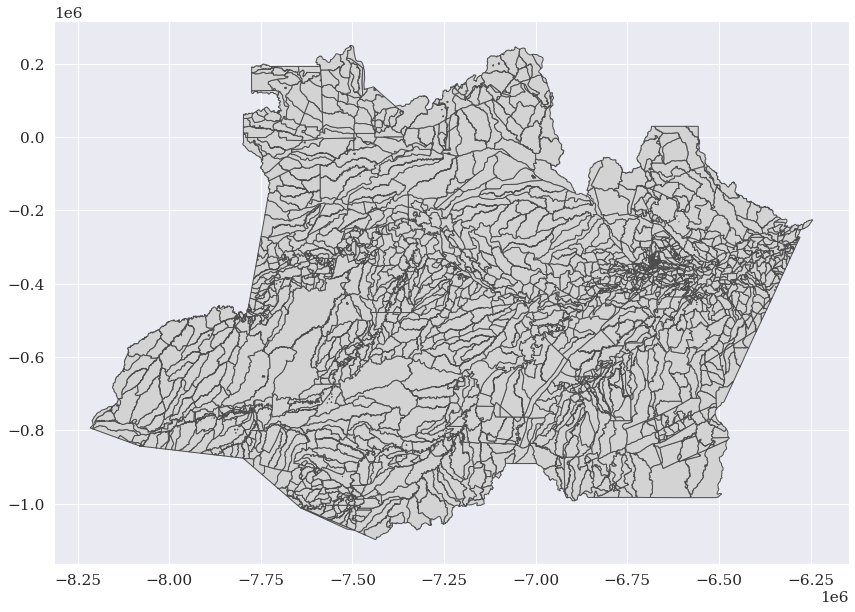

In [21]:
# Visualização
ax = am_setores_gdf.plot(
    figsize=(15, 10),
    edgecolor='0.3',
    facecolor='lightgrey')

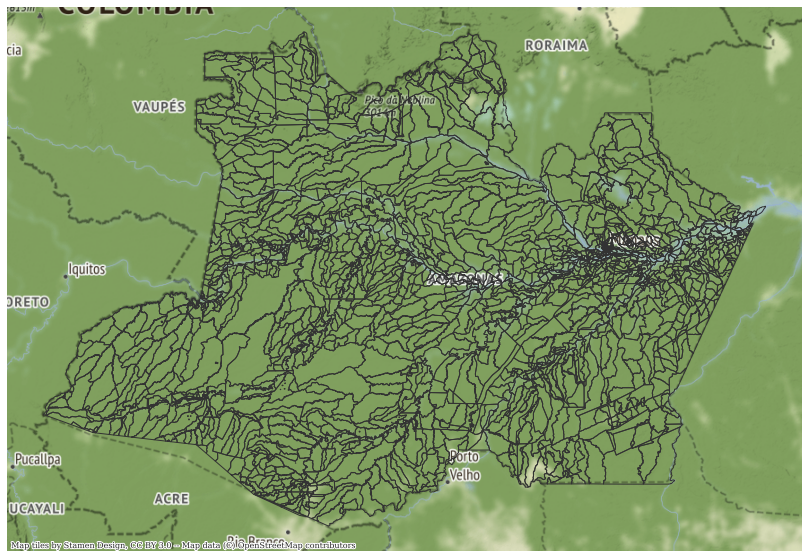

In [22]:
# Visualização
ax = am_setores_gdf.plot(
    figsize=(15, 10),
    edgecolor='0.2',
    facecolor='none')

contextily.add_basemap(ax)
ax.set_axis_off()
plt.show()

In [23]:
# Filtro para Manaus
selector = am_setores_gdf['NM_MUNICIP'] == 'MANAUS'  # máscara booleana
ma_setores_gdf = am_setores_gdf[selector]
ma_setores_gdf.shape

(2461, 14)

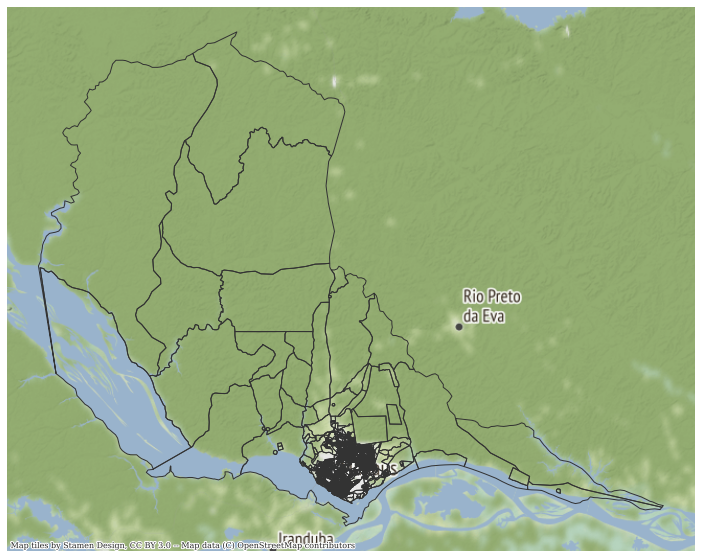

In [24]:
# Visualização de Manaus
ax = ma_setores_gdf.plot(
    figsize=(15, 10),
    edgecolor='0.2',
    facecolor='none')

contextily.add_basemap(ax)
ax.set_axis_off()
plt.show()

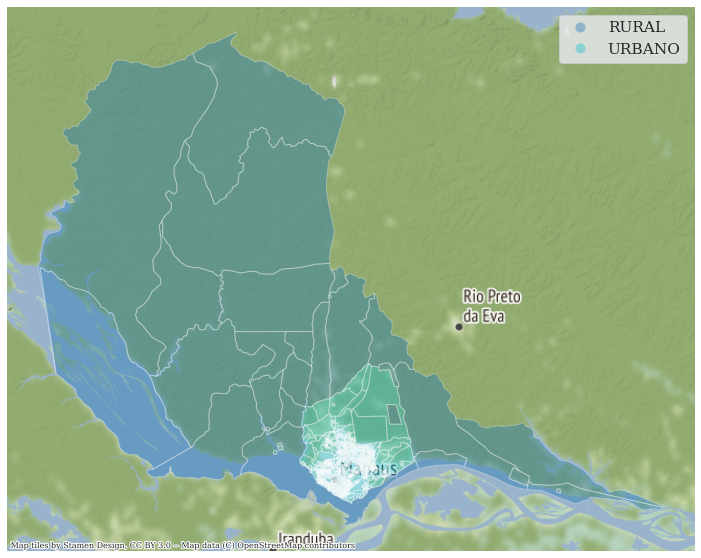

In [25]:
# Visualização de Manaus - Choropleth Maps
# https://geopandas.org/en/stable/docs/user_guide/mapping.html#choropleth-maps

ax = ma_setores_gdf.plot(
    figsize=(15, 10),
    edgecolor='none',
    column='TIPO',  # Colorir por coluna
    legend=True,
    alpha=0.4
    )

#Linhas
ma_setores_gdf.boundary.plot(
    ax=ax,
    edgecolor=(1,1,1,.3),
    linewidth=1)


contextily.add_basemap(ax)
ax.set_axis_off()
plt.show()

In [26]:
# Filtrar área urbana em Manaus
selector = ma_setores_gdf['TIPO'] == 'URBANO'
ma_setores_urb_gdf = ma_setores_gdf[selector]

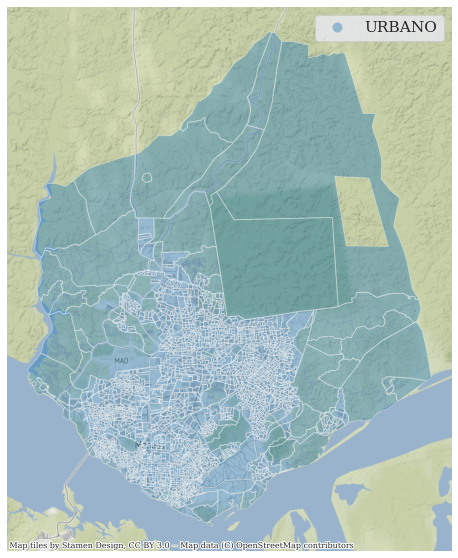

In [27]:
# Visualização de Manaus área urbana- Choropleth Maps
# https://geopandas.org/en/stable/docs/user_guide/mapping.html#choropleth-maps

ax = ma_setores_urb_gdf.plot(
    figsize=(15, 10),
    edgecolor='none',
    column='TIPO',  # Colorir por coluna
    legend=True,
    alpha=0.4
    )

#Linhas
ma_setores_urb_gdf.boundary.plot(
    ax=ax,
    edgecolor=(1,1,1,.3),
    linewidth=1)


contextily.add_basemap(ax)
ax.set_axis_off()
plt.show()

### Visualização dos Bairros

In [28]:
# Bairros da cidade de Manaus
ma_setores_urb_gdf['NM_BAIRRO'].unique()

array(['Centro', 'Nossa Senhora Aparecida', 'Presidente Vargas',
       'Compensa', 'Petrópolis', 'Japiim', 'Parque 10 de Novembro',
       'Flores', 'Aleixo', 'Cidade de Deus', 'Cidade Nova', 'Nova Cidade',
       'Alvorada', 'Nova Esperança', 'Lírio do Vale',
       'Morro da Liberdade', 'Colônia Oliveira Machado', 'Educandos',
       'Santa Luzia', None, 'Lago Azul', 'Praça 14 de Janeiro',
       'Cachoeirinha', 'Vila da Prata', 'São Jorge', 'Santo Antônio',
       'Santo Agostinho', 'São Raimundo', 'Glória', 'Planalto',
       'Ponta Negra', 'Redenção', 'Da Paz', 'Dom Pedro I', 'Tarumã',
       'Raiz', 'São Francisco', 'Coroado', 'Crespo', 'São Lázaro',
       'Betânia', 'Distrito Industrial I', 'Vila Buriti',
       'Distrito Industrial II', 'Armando Mendes', 'Gilberto Mestrinho',
       'Colônia Antônio Aleixo', 'Puraquequara', 'Mauazinho',
       'Jorge Teixeira', 'Adrianópolis', 'Nossa Senhora das Graças',
       'Chapada', 'São Geraldo', 'Novo Aleixo', 'Tancredo Neves',
      

Dentro de cada bairro há diversos setores censitários, pois estes costumam ser bem menores do que os bairros identificados pelo IBGE.

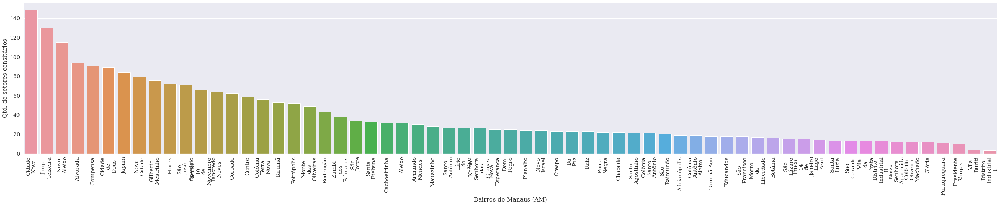

In [29]:
plt.figure(figsize=(50,8))

ax = sns.countplot(x='NM_BAIRRO',
    data=ma_setores_urb_gdf,
    order=ma_setores_urb_gdf['NM_BAIRRO'].value_counts().index  # ordem dos bairros
             )

labels = [item.get_text().replace(' ', '\n') for item in ax.get_xticklabels()]
ax.set_xticklabels(labels, rotation = 90)

ax.set_xlabel('Bairros de Manaus (AM)')
ax.set_ylabel('Qtd. de setores censitários')

plt.show()

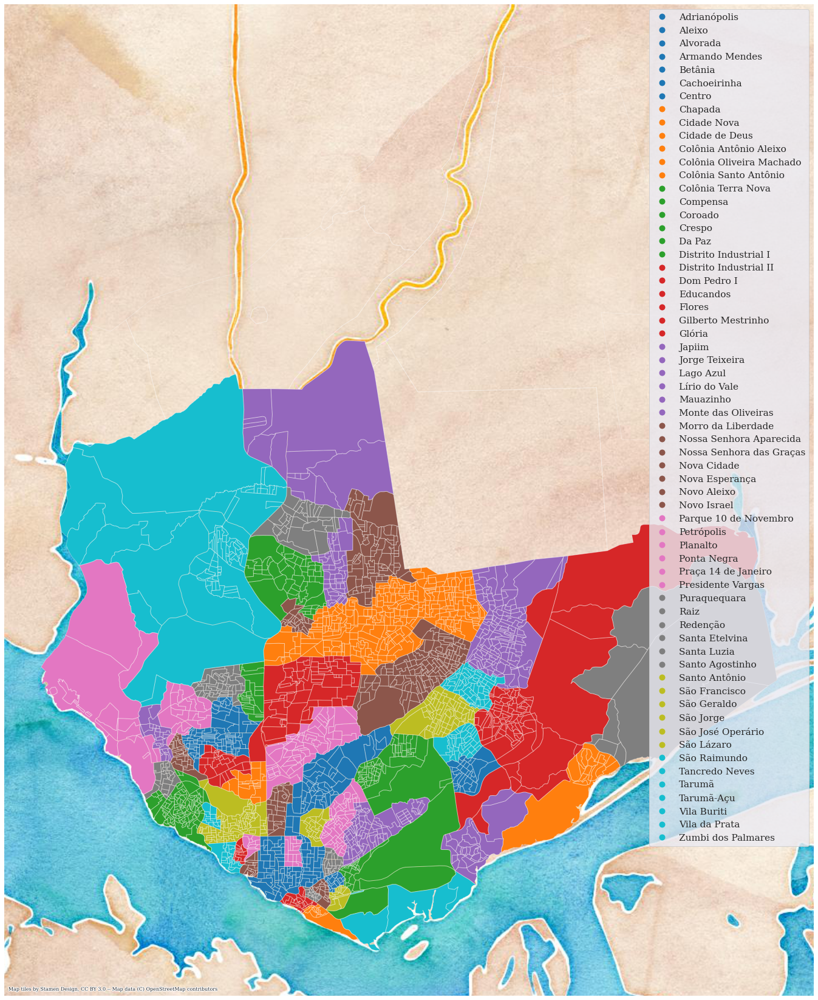

In [30]:
# Visualização dos Bairros de Manaus

# Preenchimento
ax = ma_setores_urb_gdf.plot(
    figsize=(50, 30),
    edgecolor='none',
    column='NM_BAIRRO',  # Colorir por coluna
    legend=True,
    alpha=1,
    )

#Linhas
ma_setores_urb_gdf.boundary.plot(
    ax=ax,
    edgecolor=(1,1,1,.3),
    linewidth=1)


contextily.add_basemap(ax, source=contextily.providers.Stamen.Watercolor)
ax.set_axis_off()
plt.show()

In [31]:
ma_setores_urb_gdf.to_file('/kaggle/working/mapas/mao_setores_urb.json', driver='GeoJSON')

### 1.2) Censo de 2010

* Fonte: [Instituto Brasileiro de Geografia e Estatística (IBGE)](https://www.ibge.gov.br/geociencias/downloads-geociencias.html)

In [32]:
if not os.path.exists('/kaggle/working/censo2010'):
    os.makedirs('/kaggle/working/censo2010')

In [33]:
url_censo_2010_am = 'https://ftp.ibge.gov.br/Censos/Censo_Demografico_2010/Resultados_do_Universo/Agregados_por_Setores_Censitarios/AM_20171016.zip'

%time urlretrieve(url_censo_2010_am, '/kaggle/working/censo2010/AM_20171016.zip')

CPU times: user 117 ms, sys: 54.1 ms, total: 171 ms
Wall time: 2.79 s


('/kaggle/working/censo2010/AM_20171016.zip',
 <http.client.HTTPMessage at 0x7ff0639a5f90>)

In [34]:
with zipfile.ZipFile('/kaggle/working/censo2010/AM_20171016.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/censo2010/')
    
os.remove('/kaggle/working/censo2010/AM_20171016.zip')

In [35]:
am_censo_entorno01_df = pd.read_csv('/kaggle/working/censo2010/AM/Base informaçoes setores2010 universo AM/CSV/Entorno01_AM.csv', sep=';')

## 2) O que podemos extrair de informações dos dados?

### 2.1) Limpeza e transformação de dados

In [36]:
am_censo_entorno01_df.head()

,Cod_setor,Situacao_setor,V001,V002,V003,V004,V005,V006,V007,V008,...,V194,V195,V196,V197,V198,V199,V200,V201,Unnamed: 203,Unnamed: 204
0,130002905000001,1,146,120,4,6,0,6,0,120,...,2,5,42,68,1,6,4.0,106.0,NaN,NaN
1,130002905000002,1,196,168,0,14,0,14,0,118,...,59,4,110,9,0,63,0.0,119.0,NaN,NaN
2,130002905000003,1,146,143,0,1,0,2,0,137,...,0,5,0,136,0,5,0.0,136.0,NaN,NaN
3,130002905000004,8,23,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0.0,0.0,NaN,NaN
4,130002905000006,8,103,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0.0,0.0,NaN,NaN


In [37]:
# Como os dados foram importandos?
am_censo_entorno01_df.dtypes

Cod_setor           int64
Situacao_setor      int64
V001               object
V002               object
V003               object
                   ...   
V199               object
V200              float64
V201              float64
Unnamed: 203      float64
Unnamed: 204      float64
Length: 205, dtype: object

O IBGE usa para valores nulos a string 'x'. Isso faz com que o Pandas leia as colunas como Objects ao invés de Integers. Por tanto, iremos tratar essas colunas e converteê-las.

In [38]:
# Seleção de colunas de interesse
# Domicílio próprios, alugados, cedidos
# Pula-se os casos negativos (não tem pavimentação)
colunas = [
    'V001', # Domicílios
    'V008', 'V010', 'V012', # Iluminação pública
    'V014', 'V016', 'V018', # Pavimentação
    'V020', 'V022', 'V024', # Calçada
    'V038', 'V040', 'V042', # Rampa para cadeirante
    'V044', 'V046', 'V048'] # Arborização

# Tratamento das colunas
am_censo_entorno01_df[colunas] = am_censo_entorno01_df[colunas].replace('X', '0')

In [39]:
# Conversão do tipo de coluna
am_censo_entorno01_df[colunas] = am_censo_entorno01_df[colunas].astype(int, copy=False)
am_censo_entorno01_df.dtypes

Cod_setor           int64
Situacao_setor      int64
V001                int64
V002               object
V003               object
                   ...   
V199               object
V200              float64
V201              float64
Unnamed: 203      float64
Unnamed: 204      float64
Length: 205, dtype: object

In [40]:
# Seleção de colunas de interesse
am_gdf = am_censo_entorno01_df[['Cod_setor'] + colunas]
am_gdf.head()

,Cod_setor,V001,V008,V010,V012,V014,V016,V018,V020,V022,V024,V038,V040,V042,V044,V046,V048
0,130002905000001,146,120,6,6,120,6,6,43,0,6,0,0,0,40,3,3
1,130002905000002,196,118,11,9,168,14,14,41,4,0,0,0,0,0,0,0
2,130002905000003,146,137,1,2,142,1,2,22,1,1,0,0,0,82,0,2
3,130002905000004,23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,130002905000006,103,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [41]:
# Síntese dos contextos
am_gdf.loc[:,'ILUMINACAO'] = am_gdf.loc[:, 'V008':'V012'].sum(axis=1)
am_gdf.loc[:,'PAVIMENTACAO'] = am_gdf.loc[:, 'V014':'V018'].sum(axis=1)
am_gdf.loc[:,'CALCADA'] = am_gdf.loc[:, 'V020':'V024'].sum(axis=1)
am_gdf.loc[:,'RAMPA_CADEIRANTE'] = am_gdf.loc[:, 'V038':'V042'].sum(axis=1)
am_gdf.loc[:,'ARBORIZACAO'] = am_gdf.loc[:, 'V044':'V048'].sum(axis=1)

am_gdf.head()

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:1667: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value


,Cod_setor,V001,V008,V010,V012,V014,V016,V018,V020,V022,...,V040,V042,V044,V046,V048,ILUMINACAO,PAVIMENTACAO,CALCADA,RAMPA_CADEIRANTE,ARBORIZACAO
0,130002905000001,146,120,6,6,120,6,6,43,0,...,0,0,40,3,3,132,132,49,0,46
1,130002905000002,196,118,11,9,168,14,14,41,4,...,0,0,0,0,0,138,196,45,0,0
2,130002905000003,146,137,1,2,142,1,2,22,1,...,0,0,82,0,2,140,145,24,0,84
3,130002905000004,23,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,130002905000006,103,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [42]:
# Remoção das colunas desnecessárias
am_gdf = am_gdf.drop(columns=colunas[1:]).copy()
am_gdf.head()

,Cod_setor,V001,ILUMINACAO,PAVIMENTACAO,CALCADA,RAMPA_CADEIRANTE,ARBORIZACAO
0,130002905000001,146,132,132,49,0,46
1,130002905000002,196,138,196,45,0,0
2,130002905000003,146,140,145,24,0,84
3,130002905000004,23,0,0,0,0,0
4,130002905000006,103,0,0,0,0,0


In [43]:
# Renomeação das colunas
am_gdf.columns = ['CD_GEOCODI', 'DOMICILIOS', 'ILUMINACAO', 'PAVIMENTACAO', 'CALCADA', 'RAMPA_CADEIRANTE', 'ARBORIZACAO']
am_gdf.head()

,CD_GEOCODI,DOMICILIOS,ILUMINACAO,PAVIMENTACAO,CALCADA,RAMPA_CADEIRANTE,ARBORIZACAO
0,130002905000001,146,132,132,49,0,46
1,130002905000002,196,138,196,45,0,0
2,130002905000003,146,140,145,24,0,84
3,130002905000004,23,0,0,0,0,0
4,130002905000006,103,0,0,0,0,0


### Mesclagem de Tabelas

In [44]:
# Mesclagem de dados
ma_setores_urb_gdf.loc[:,'CD_GEOCODI'] = ma_setores_urb_gdf.loc[:,'CD_GEOCODI'].astype(int, copy=True)
am_gdf = pd.merge(ma_setores_urb_gdf[['CD_GEOCODI', 'NM_BAIRRO', 'geometry']], am_gdf, on='CD_GEOCODI')

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [45]:
# Remoção dos registros nulos
am_gdf = am_gdf.dropna().copy()
am_gdf.head()

,CD_GEOCODI,NM_BAIRRO,geometry,DOMICILIOS,ILUMINACAO,PAVIMENTACAO,CALCADA,RAMPA_CADEIRANTE,ARBORIZACAO
0,130260305060048,Centro,"POLYGON ((-6680884.102 -348958.522, -6680865.1...",213,213,213,213,23,25
1,130260305060049,Centro,"POLYGON ((-6680785.198 -349373.286, -6680805.2...",164,159,159,156,4,44
2,130260305060050,Centro,"POLYGON ((-6680330.912 -349138.824, -6680330.7...",0,0,0,0,0,0
3,130260305060051,Nossa Senhora Aparecida,"POLYGON ((-6682377.898 -348005.096, -6682377.5...",166,166,166,132,0,47
4,130260305060052,Nossa Senhora Aparecida,"POLYGON ((-6682377.898 -348005.096, -6682374.1...",208,208,208,156,0,185


In [46]:
am_gdf.shape

(2396, 9)

In [47]:
am_gdf.crs.to_string()

'EPSG:3857'

In [48]:
def crs_describe(gdf):
    # CRS
    import json
    print('SRC:', gdf.crs.to_string(), '\n')


    print('Nome:', json.loads(gdf.crs.to_json())['name'])
    print('EPSG:', gdf.crs.to_epsg())
    print('Tipo:', json.loads(gdf.crs.to_json())['type'], json.loads(gdf.crs.to_json())['coordinate_system']['subtype'])
    print('Unidade:', [axis['unit'] for axis in json.loads(gdf.crs.to_json())['coordinate_system']['axis']])

    print('\nPROJ4:', gdf.crs.to_proj4())

    print('\nJSON:', json.loads(gdf.crs.to_json()))

crs_describe(am_gdf)

SRC: EPSG:3857 

Nome: WGS 84 / Pseudo-Mercator
EPSG: 3857
Tipo: ProjectedCRS Cartesian
Unidade: ['metre', 'metre']

PROJ4: +proj=merc +a=6378137 +b=6378137 +lat_ts=0 +lon_0=0 +x_0=0 +y_0=0 +k=1 +units=m +nadgrids=@null +wktext +no_defs +type=crs

JSON: {'$schema': 'https://proj.org/schemas/v0.2/projjson.schema.json', 'type': 'ProjectedCRS', 'name': 'WGS 84 / Pseudo-Mercator', 'base_crs': {'name': 'WGS 84', 'datum': {'type': 'GeodeticReferenceFrame', 'name': 'World Geodetic System 1984', 'ellipsoid': {'name': 'WGS 84', 'semi_major_axis': 6378137, 'inverse_flattening': 298.257223563}}, 'coordinate_system': {'subtype': 'ellipsoidal', 'axis': [{'name': 'Geodetic latitude', 'abbreviation': 'Lat', 'direction': 'north', 'unit': 'degree'}, {'name': 'Geodetic longitude', 'abbreviation': 'Lon', 'direction': 'east', 'unit': 'degree'}]}, 'id': {'authority': 'EPSG', 'code': 4326}}, 'conversion': {'name': 'Popular Visualisation Pseudo-Mercator', 'method': {'name': 'Popular Visualisation Pseudo Merc

/opt/conda/lib/python3.7/site-packages/pyproj/crs/crs.py:1216: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  return self._crs.to_proj4(version=version)


In [49]:
# Tranformação de SRC
am_gdf = am_gdf.to_crs(crs='EPSG:4326')

crs_describe(am_gdf)

SRC: EPSG:4326 

Nome: WGS 84
EPSG: 4326
Tipo: GeographicCRS ellipsoidal
Unidade: ['degree', 'degree']

PROJ4: +proj=longlat +datum=WGS84 +no_defs +type=crs

JSON: {'$schema': 'https://proj.org/schemas/v0.2/projjson.schema.json', 'type': 'GeographicCRS', 'name': 'WGS 84', 'datum': {'type': 'GeodeticReferenceFrame', 'name': 'World Geodetic System 1984', 'ellipsoid': {'name': 'WGS 84', 'semi_major_axis': 6378137, 'inverse_flattening': 298.257223563}}, 'coordinate_system': {'subtype': 'ellipsoidal', 'axis': [{'name': 'Geodetic latitude', 'abbreviation': 'Lat', 'direction': 'north', 'unit': 'degree'}, {'name': 'Geodetic longitude', 'abbreviation': 'Lon', 'direction': 'east', 'unit': 'degree'}]}, 'scope': 'Horizontal component of 3D system.', 'area': 'World.', 'bbox': {'south_latitude': -90, 'west_longitude': -180, 'north_latitude': 90, 'east_longitude': 180}, 'id': {'authority': 'EPSG', 'code': 4326}}


/opt/conda/lib/python3.7/site-packages/pyproj/crs/crs.py:1216: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  return self._crs.to_proj4(version=version)


### 2.2) Visualizando informações de bairros

In [50]:
# Mapas Interativos
import folium

In [98]:
coord_centro_manaus = [-3.1019400, -60.0250000]
mapa_manaus = folium.Map(location=coord_centro_manaus, zoom_start=12, 
                         #tiles='stamen watercolor'
                        )
mapa_manaus

In [96]:
%%time
resolution, width, height = 100, 5, 5

for row in am_gdf.values:
    setor_geo = folium.GeoJson(row[2])
    
    setor_geo_id = row[0]
    setor_geo_bairro = row[1]
    
    html = '<h2>{}</h2>'.format('Setor Censitário: ' + str(setor_geo_id))
    html += '<hr>'
    html += '<p>{}</p>'.format('Bairro: ' + setor_geo_bairro)
    html += '<hr>'
    html += am_gdf[am_gdf['CD_GEOCODI'] == setor_geo_id][['DOMICILIOS', 
                                                          'ILUMINACAO', 
                                                          'PAVIMENTACAO']].to_html(index=False)
    html += am_gdf[am_gdf['CD_GEOCODI'] == setor_geo_id][['CALCADA',
                                                          'RAMPA_CADEIRANTE',
                                                          'ARBORIZACAO']].to_html(index=False)
    
    iframe = folium.IFrame(html, width=(width*resolution)+20, height=(height*resolution)+20)
    setor_geo.add_child(folium.Popup(iframe, max_width=2650))
    
    mapa_manaus.add_child(setor_geo)

CPU times: user 16.7 s, sys: 300 ms, total: 17 s
Wall time: 17 s


In [99]:
%%time

# PAGE SETUP
coord_centro_manaus = [-3.1019400, -60.0250000]
mapa_manaus = folium.Map(location=coord_centro_manaus, zoom_start=12, 
                         #tiles='stamen watercolor'
                        )
# POPUP SETUP
resolution, width, height = 100, 5, 5

# FEATURES
for index, row in am_gdf.iterrows():
    
    
    # POPUP - Clicked
    setor_geo_id = row['CD_GEOCODI'] 
    setor_geo_bairro = row['NM_BAIRRO']
    
    html = '<h2>{}</h2>'.format('Setor Censitário: ' + str(setor_geo_id))
    html += '<hr>'
    html += '<p>{}</p>'.format('Bairro: ' + setor_geo_bairro)
    html += '<hr>'
    # tabela
    html += row[['DOMICILIOS', 
                 'ILUMINACAO', 
                 'PAVIMENTACAO']].to_frame().T.to_html(index=False)
    html += row[['CALCADA',
                 'RAMPA_CADEIRANTE',
                 'ARBORIZACAO']].to_frame().T.to_html(index=False)
    iframe = folium.IFrame(html, width=(width*resolution)+20, height=(height*resolution)+20)
    
    # IMAGEM
    setor_geo = folium.GeoJson(row['geometry'])  # geometry
    setor_geo.add_child(folium.Popup(iframe, max_width=2650))  # popup
    
    mapa_manaus.add_child(setor_geo)  # add feature to map

CPU times: user 14.5 s, sys: 137 ms, total: 14.6 s
Wall time: 14.6 s


In [100]:
mapa_manaus

In [101]:
mapa_manaus.save('mapa_manaus_setores_censitarios.html')

### 2.3) Criação de mapas coropléticos com os dados do IBGE

DO Grego, Choros: região, área; Plethos: Multitude

[Ler mais: WIKIPEDIA](https://en.wikipedia.org/wiki/Choropleth_map)

In [102]:
coord_centro_manaus = [-3.1019400, -60.0250000]
mapa_manaus = folium.Map(location=coord_centro_manaus, zoom_start=12)

In [103]:
folium.Choropleth(geo_data = am_gdf,
                  name = 'Domicílios',
                  data = am_gdf,
                  columns = ['CD_GEOCODI', 'DOMICILIOS'],
                  key_on = 'feature.properties.CD_GEOCODI',
                  fill_color = 'RdGy',
                  fill_opacity = 0.75,
                  line_opacity = 0.75,
                  legend_name = 'Domicílios').add_to(mapa_manaus)

folium.Choropleth(geo_data = am_gdf,
                  name = 'Iluminação Pública',
                  data = am_gdf,
                  columns = ['CD_GEOCODI', 'ILUMINACAO'],
                  key_on = 'feature.properties.CD_GEOCODI',
                  fill_color = 'RdGy',
                  fill_opacity = 0.75,
                  line_opacity = 0.75,
                  legend_name = 'Iluminação Pública').add_to(mapa_manaus)

folium.Choropleth(geo_data = am_gdf,
                  name = 'Rampas para cadeirantes',
                  data = am_gdf,
                  columns = ['CD_GEOCODI', 'RAMPA_CADEIRANTE'],
                  key_on = 'feature.properties.CD_GEOCODI',
                  fill_color = 'RdGy',
                  fill_opacity = 0.75,
                  line_opacity = 0.75,
                  legend_name = 'Rampas para cadeirantes').add_to(mapa_manaus)

folium.Choropleth(geo_data = am_gdf,
                  name = 'Arborização',
                  data = am_gdf,
                  columns = ['CD_GEOCODI', 'ARBORIZACAO'],
                  key_on = 'feature.properties.CD_GEOCODI',
                  fill_color = 'RdGy',
                  fill_opacity = 0.75,
                  line_opacity = 0.75,
                  legend_name = 'Arborização').add_to(mapa_manaus)

folium.LayerControl().add_to(mapa_manaus)

In [104]:
%%time
mapa_manaus.save('mapa_manaus_entorno.html')

In [105]:
%%time
mapa_manaus

----

# Contextily

<AxesSubplot:title={'center':'São Paulo, Região Imediata de São Paulo, Região Metropolitana de São Paulo, Região Geográfica Intermediária de São Paulo, São Paulo, Região Sudeste, Brasil'}, xlabel='X', ylabel='Y'>

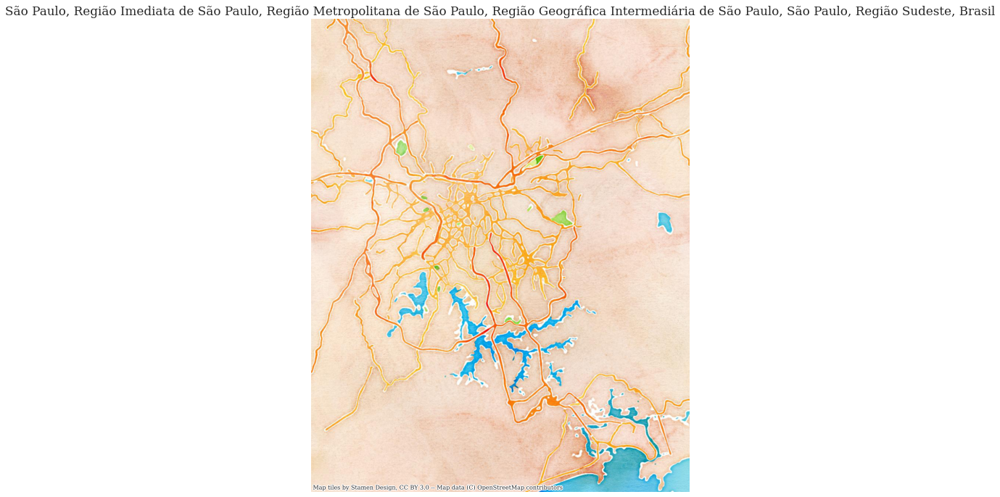

In [77]:
import contextily as cx
tempe = cx.Place("Sao Paulo, SP", source=cx.providers.Stamen.Watercolor)
tempe.plot()

# SALVAR IMAGEM NO LOCAL
#bristol = cx.Place("Bristol, UK", path="bristol.tif")
#with rasterio.open("bristol.tif") as r:
#    rioshow(r)

In [ ]:
https://contextily.readthedocs.io/en/latest/intro_guide.html
#Providers

# cx.providers.Stamen.Toner - Black & White ala Delija
# cx.providers.Stamen.TonerLite
# cx.providers.CartoDB.Voyager
# cx.providers.CartoDB.Positron
# cx.providers.NASAGIBS.ViirsEarthAtNight2012

# cx.providers.Stamen.Watercolor

In [32]:
# BAIRRO
# SUB-DISTRITO
# DISTRITO - Divisões adm internas ao Município (em Manaus possui o mesmo nome do que o Município)
# MUNICÍPIO - Menor unidade da federação

selector = ma_setores_urb_gdf['NM_BAIRRO'] != ma_setores_urb_gdf['NM_DISTRIT']
ma_setores_urb_gdf[selector]

,ID,CD_GEOCODI,TIPO,CD_GEOCODB,NM_BAIRRO,CD_GEOCODS,NM_SUBDIST,CD_GEOCODD,NM_DISTRIT,CD_GEOCODM,NM_MUNICIP,NM_MICRO,NM_MESO,geometry
0,3215,130260305060048,URBANO,130260305001,Centro,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6680884.102 -348958.522, -6680865.1..."
1,3216,130260305060049,URBANO,130260305001,Centro,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6680785.198 -349373.286, -6680805.2..."
2,3217,130260305060050,URBANO,130260305001,Centro,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6680330.912 -349138.824, -6680330.7..."
3,3218,130260305060051,URBANO,130260305002,Nossa Senhora Aparecida,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6682377.898 -348005.096, -6682377.5..."
4,3219,130260305060052,URBANO,130260305002,Nossa Senhora Aparecida,13026030506,PRIMEIRA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6682377.898 -348005.096, -6682374.1..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4672,5573,130260305140374,URBANO,130260305055,Tancredo Neves,13026030514,NONA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6672297.156 -341174.001, -6672248.7..."
4673,5574,130260305140375,URBANO,130260305055,Tancredo Neves,13026030514,NONA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6671453.782 -339908.536, -6671428.1..."
4674,5575,130260305140376,URBANO,130260305054,São José Operário,13026030514,NONA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6673025.186 -340684.047, -6673021.3..."
4675,5576,130260305140377,URBANO,130260305055,Tancredo Neves,13026030514,NONA R.A.,130260305,MANAUS,1302603,MANAUS,MANAUS,CENTRO AMAZONENSE,"POLYGON ((-6672159.214 -341261.548, -6672133.0..."


### Teste de Velocidade do Tipo de Arquivo

Faz diferença na performance ler um SHP ou um ZIP contendo este arquivo?

No teste a seguir, fazeremos dois experimentos de leitura para esses estes tipos de arquivos e contaremos o tempo de processamento.

**RESULTADO**: 

ZIP é **9%** mais lento do que o SHP.

In [ ]:
%%timeit -n 20

am_setores_shp = '/kaggle/working/mapas/13SEE250GC_SIR.shp'

# GeoPandas lê tanto arquivo SHP quanto o ZIP
am_setores_gdf = gpd.read_file(am_setores_shp)
am_setores_gdf.head()

In [ ]:
%%timeit -n 20

am_setores_zip = '/kaggle/working/mapas/am_setores_censitarios.zip'

# GeoPandas lê tanto arquivo SHP quanto o ZIP
am_setores_gdf = gpd.read_file(am_setores_zip)
am_setores_gdf.head()

In [ ]:
https://produto.mercadolivre.com.br/MLB-1296055259-macaco-brim-pesado-manga-curta-uniforme-preto-_JM#reco_item_pos=1&reco_backend=machinalis-seller-items-pdp&reco_backend_type=low_level&reco_client=vip-seller_items-above&reco_id=011f412c-c1f5-4d64-8844-1cdfbcbee9ab
    https://www.superepi.com.br/pesquisa?t=Macac%C3%A3o+de+Prote%C3%A7%C3%A3o